# Код из документации

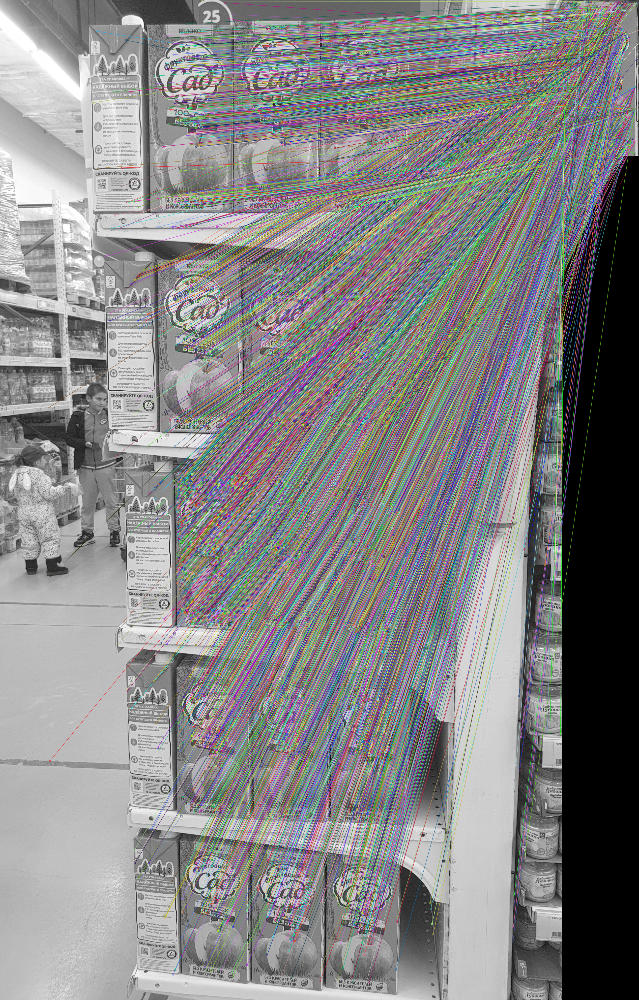

In [ ]:
import numpy as np
import cv2 as cv
import matplotlib.pyplot as plt
from google.colab.patches import cv2_imshow

#img1 = cv.imread('box.png',cv.IMREAD_GRAYSCALE) # queryImage
#img2 = cv.imread('box_in_scene.png',cv.IMREAD_GRAYSCALE) # trainImage

img1 = cv.imread('/content/train_1.jpg',0)
img2 = cv.imread('/content/template_1.jpg',0)

# Initiate SIFT detector
sift = cv.SIFT_create()

# find the keypoints and descriptors with SIFT
kp1, des1 = sift.detectAndCompute(img1,None)
kp2, des2 = sift.detectAndCompute(img2,None)

#img2=cv.drawKeypoints(img2,kp2,img2)

#plt.imshow(img1),plt.show()
#cv2_imshow(img2) #Эта команда лучше всего выводит картинки.
bf = cv.BFMatcher()
#matches = bf.match(des1,des2)
matches = bf.knnMatch(des1,des2,k=2)
len(matches)
#for match in matches:
#  p1 = kp1[match.queryIdx].pt
#  p2 = kp2[match.trainIdx].pt

# Apply ratio test
good = []
for m,n in matches:
  if m.distance < 0.3*n.distance:
    good.append([m])

 #cv.drawMatchesKnn expects list of lists as matches.
img3 = cv.drawMatchesKnn(img1,kp1,img2,kp2,good,None,flags= 2)

cv2_imshow(img3) #Эта команда лучше всего выводит картинки.

In [ ]:
import numpy as np
import cv2 as cv

#код от паши

img1 = cv.imread('/content/train_1.jpg',0)
img2 = cv.imread('/content/template_1.jpg',0)


sift = cv.SIFT_create()
kp = sift.detect(img1,None)

img1=cv.drawKeypoints(img1,kp,img1)

plt.imshow(img3),plt.show()

error: OpenCV(4.8.0) /io/opencv/modules/imgproc/src/color.cpp:182: error: (-215:Assertion failed) !_src.empty() in function 'cvtColor'


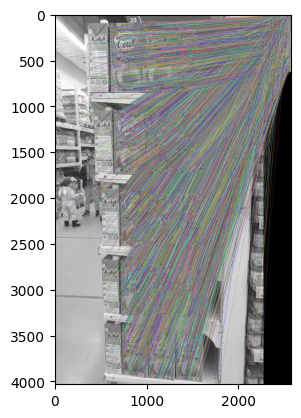

(<matplotlib.image.AxesImage at 0x7c6c22c987c0>, None)

In [ ]:
# BFMatcher with default params
bf = cv.BFMatcher()
matches = bf.knnMatch(des1,des2,k=2)


# Apply ratio test
good = []
for m,n in matches:
  if m.distance < 0.75*n.distance:
    good.append([m])

 #cv.drawMatchesKnn expects list of lists as matches.
img3 = cv.drawMatchesKnn(img1,kp1,img2,kp2,good,None,flags= 2) #cv.DrawMatchesFlags_NOT_DRAW_SINGLE_POINTS)

plt.imshow(img3),plt.show()

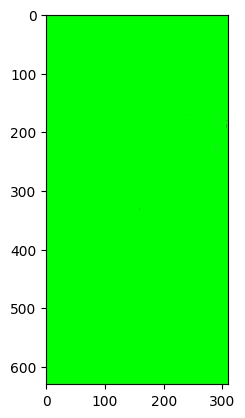

Выходные данные были обрезаны до нескольких последних строк (5000).
Коробка 11168: Точка верхнего левого угла (191, 472), Точка нижнего правого угла (391, 672)
Коробка 11169: Точка верхнего левого угла (193, 340), Точка нижнего правого угла (393, 540)
Коробка 11170: Точка верхнего левого угла (-65, 521), Точка нижнего правого угла (134, 721)
Коробка 11171: Точка верхнего левого угла (-65, 521), Точка нижнего правого угла (134, 721)
Коробка 11172: Точка верхнего левого угла (171, 459), Точка нижнего правого угла (371, 659)
Коробка 11173: Точка верхнего левого угла (193, 340), Точка нижнего правого угла (393, 540)
Коробка 11174: Точка верхнего левого угла (183, 472), Точка нижнего правого угла (383, 672)
Коробка 11175: Точка верхнего левого угла (184, 461), Точка нижнего правого угла (384, 661)
Коробка 11176: Точка верхнего левого угла (175, 472), Точка нижнего правого угла (375, 672)
Коробка 11177: Точка верхнего левого угла (174, 460), Точка нижнего правого угла (374, 660)
Коробка 1117

In [ ]:
# Получение координат углов рамок
bounding_boxes = []  # Здесь будут храниться координаты рамок

for match in good:
    query_idx = match[0].queryIdx
    train_idx = match[0].trainIdx

    # Получение координат ключевых точек для обоих изображений
    query_point = kp1[query_idx].pt
    train_point = kp2[train_idx].pt

    # Размер коробки сока в изображении img1 (queryImage)
    box_width = 200
    box_height =  200

    # Координаты углов рамки вокруг коробки на изображении img2 (trainImage)
    top_left = (int(train_point[0] - box_width/2), int(train_point[1] - box_height/2))
    bottom_right = (int(train_point[0] + box_width/2), int(train_point[1] + box_height/2))

    bounding_boxes.append((top_left, bottom_right))

# Отрисовка рамок вокруг коробок сока на изображении img2
img_with_boxes = cv.cvtColor(img2, cv.COLOR_GRAY2BGR)
for box in bounding_boxes:
    cv.rectangle(img_with_boxes, box[0], box[1], (0, 255, 0), 2)  # Рисование зеленой рамки

plt.imshow(img_with_boxes)
plt.show()

# Вывод координат рамок
for i, box in enumerate(bounding_boxes):
    print(f"Коробка {i+1}: Точка верхнего левого угла {box[0]}, Точка нижнего правого угла {box[1]}")

# ТАК ЭТО КОД ИЗ ИНЕТА



*   Новый пункт
*   Новый пункт



In [ ]:
import os
import shutil
import numpy as np
import cv2 as cv
import logging

# Setup logging
logging.basicConfig(level=logging.INFO, format='%(asctime)s - %(levelname)s - %(message)s')

# Define directories
train_directory = 'input/lab3/train'
template_directory = 'input/lab3'
output_directory = 'lab3-result'

# Clear the output directory
if os.path.exists(output_directory):
    shutil.rmtree(output_directory)
os.makedirs(output_directory)

def is_image_file(filename):
    return filename.lower().endswith(('.png', '.jpg', '.jpeg'))

def pad_images(img1, img2):
    h1, w1 = img1.shape[:2]
    h2, w2 = img2.shape[:2]
    if h1 < h2:
        img1 = cv.copyMakeBorder(img1, 0, h2 - h1, 0, 0, cv.BORDER_CONSTANT, value=[0, 0, 0])
    else:
        img2 = cv.copyMakeBorder(img2, 0, h1 - h2, 0, 0, cv.BORDER_CONSTANT, value=[0, 0, 0])
    return img1, img2

def process_and_save(method_name, detector, matcher, train_directory, template_directory, output_directory, use_knn=False, ratio_test=False):
    method_dir = os.path.join(output_directory, method_name)
    os.makedirs(method_dir, exist_ok=True)
    logging.info(f"Processing with method: {method_name}")

    train_files = [os.path.join(train_directory, f) for f in os.listdir(train_directory) if is_image_file(f)]
    template_files = [os.path.join(template_directory, f) for f in os.listdir(template_directory) if is_image_file(f)]

    for train_file in train_files:
        original_img = cv.imread(train_file)
        if original_img is None:
            logging.warning(f"Failed to load training image {train_file}")
            continue

        img2_gray = cv.cvtColor(original_img, cv.COLOR_BGR2GRAY)
        img2_color = original_img.copy()  # Create a copy for drawing
        mask = np.ones(img2_gray.shape, dtype=np.uint8) * 255  # Initialize mask

        for template_file in template_files:
            img1 = cv.imread(template_file)
            if img1 is None:
                logging.warning(f"Failed to load template image {template_file}")
                continue

            img1_gray = cv.cvtColor(img1, cv.COLOR_BGR2GRAY)
            kp1, des1 = detector.detectAndCompute(img1_gray, None)

            while True:
                kp2, des2 = detector.detectAndCompute(img2_gray, mask)
                if des1 is None or des2 is None:
                    logging.info("Descriptors not found, skipping match.")
                    break

                if use_knn:
                    raw_matches = matcher.knnMatch(des1, des2, k=2)
                    matches = [m for m, n in raw_matches if m.distance < 0.75 * n.distance] if ratio_test else [m[0] for m in raw_matches]
                else:
                    matches = matcher.match(des1, des2)
                    matches = sorted(matches, key=lambda x: x.distance)

                if len(matches) > 10:
                    src_pts = np.float32([kp1[m.queryIdx].pt for m in matches]).reshape(-1, 1, 2)
                    dst_pts = np.float32([kp2[m.trainIdx].pt for m in matches]).reshape(-1, 1, 2)
                    M, mask_homography = cv.findHomography(src_pts, dst_pts, cv.RANSAC, 5.0)
                    if M is not None and mask_homography.sum() > 10:
                        h, w = img1.shape[:2]
                        pts = np.float32([[0, 0], [0, h-1], [w-1, h-1], [w-1, 0]]).reshape(-1, 1, 2)
                        dst = cv.perspectiveTransform(pts, M)
                        img2_color = cv.polylines(img2_color, [np.int32(dst)], True, (0, 255, 0), 3, cv.LINE_AA)
                        cv.fillConvexPoly(mask, np.int32(dst), 0)
                        logging.info("Match found and mask updated.")
                    else:
                        break  # No good homography found
                else:
                    break  # Not enough matches

            img1, img2_color = pad_images(img1, img2_color)
            combined_img = np.concatenate((img1, img2_color), axis=1)
            output_file = os.path.join(method_dir, f"{os.path.basename(train_file)}_{os.path.basename(template_file)}.png")
            cv.imwrite(output_file, combined_img)
            logging.info(f"Result saved: {output_file}")

# Initialize detectors and matchers
sift = cv.SIFT_create()
bf_sift = cv.BFMatcher(cv.NORM_L2, crossCheck=False)
FLANN_INDEX_KDTREE = 1
index_params = dict(algorithm=FLANN_INDEX_KDTREE, trees=5)
search_params = dict(checks=50)
flann = cv.FlannBasedMatcher(index_params, search_params)

# Process images with different methods
process_and_save('sift_bf', sift, bf_sift, train_directory, template_directory, output_directory, use_knn=True, ratio_test=True)
process_and_save('sift_flann', sift, flann, train_directory, template_directory, output_directory, use_knn=True, ratio_test=True)


# Функция

In [45]:
import numpy as np
import cv2 as cv
import matplotlib.pyplot as plt
from google.colab.patches import cv2_imshow


def predict_image(img: np.ndarray, query: np.ndarray) -> list:

  #list_of_boxes = [(0, 0, 1, 1)]

  gray_img = cv.cvtColor(img, cv.COLOR_BGR2GRAY)
  gray_query = cv.cvtColor(query, cv.COLOR_BGR2GRAY)

  sift = cv.SIFT_create()

  # find the keypoints and descriptors with SIFT
  kp1, des1 = sift.detectAndCompute(gray_img,None)
  kp2, des2 = sift.detectAndCompute(gray_query,None)



  #Поиск совпадений и сортировка совпадений
  bf = cv.BFMatcher(cv.NORM_L1, crossCheck = False)
  #crossCheck=false - совпадения вида один ко многим, crossCheck=true - совпадения вида один к одному
  matches = bf.match(des1,des2)
  matches = sorted(matches, key = lambda x:x.distance)

  print('Найдено связей: ' + str(len(matches)))


    #Соотносим особые точки и находим матрицу гомографии
  matches = matches[:5000]

  #изображение куда будем наносит рамки найденных предметов
  img_to_show = img.copy()

  #Основной цикл
  count = 0

  while(True):
    print('==============')
    print('Цикл № ' + str(count))
    count = count + 1


    new1 = np.float32([kp1[m.queryIdx].pt for m in matches]) # координаты контрольной точки для 1-ого изображения
    new2 = np.float32([kp2[m.trainIdx].pt for m in matches]) # координаты контрольной точки для 2-ого изображения


    H, status = cv.findHomography(new2, new1, cv.RANSAC, 4.0)

    print('В текущем цикле найдено совпадений: ' + str(status.sum()))

    #Если матрица гомографии не найдена или совпадений слишком мало
    if ((H is None) or (status.sum() < 8)):
      print("Завершение в связи с недостатком совпадений")
      cv2_imshow(img_to_show)
      return

    #Будем рисовать те точки, которые нам понравились
    for index in range(len(status)-1, 0, -1):
      if (status[index, 0]):
        #Находим какой индекс имеет данная точка в общем плане
        index_train = matches[index].queryIdx
        #Находим координаты этой точки в общем плане
        x, y = kp1[index_train].pt
        cv.circle(img_to_show,(int(x),int(y)), 3,(0,255,0), -1)




    #ДЕБАГГГГ
    #if(count == 3):
    #  print("Завершение в связи с ДЕБАГОМ")
    #  cv2_imshow(img_to_show)
    #  return










  #Делаем белое изображение
    white_query = np.ones_like(gray_query) * 255


  #qeury_transformed = cv.warpPerspective(query, H, (img.shape[1],img.shape[0]),flags=cv.INTER_NEAREST )
  #print("Матрица H = ")
  #print(H)

  #print('Размер белого')
  #print(white_query.shape)

    #рисует совпадения, но нам не надо
    #match_res = cv.drawMatches(img, kp1, query, kp2, matches, None, [255,0,0], flags=2)

    #cv2_imshow(match_res)

    width = query.shape[1]
    height = query.shape[0]

    corners_query = np.float32([[0, 0], [0, height-1], [width-1, height-1], [width-1, 0]]).reshape(-1, 1, 2)

    #Углы идут против часовой стрелки начиная с верхнего левого( потом нижний левый, потом нижний правый)

    #Исходный размер сока 310x630
    #значит площадь 195 300

    corners_query_transformed = cv.perspectiveTransform(corners_query, H)

    print(corners_query_transformed)



    #Трансформируем белое
    white_transformed = cv.warpPerspective(white_query, H, (img.shape[1],img.shape[0]),flags=cv.INTER_NEAREST )

    #Инвертируем белое
    white_transformed_inv = cv.bitwise_not(white_transformed)


    #наносим на изображение, чтобы сок был черным
    #base_image = cv.bitwise_and(img, img, mask=white_transformed_inv)

    #cv.fillConvexPoly(base_image, np.int32(corners_query_transformed), 0)

    base_image = img.copy()

    cv.polylines(img_to_show, [corners_query_transformed.astype(np.int32)], True,(0,255,255), 10)

    corners_q_tr = corners_query_transformed.astype(np.int32)

    #Удаляем избыточный внутренний массив
    corners_q_tr_norm = corners_q_tr.squeeze()

    #проверяем какие точки в matches входят в площадь четырехугольника
    # Координаты точки для проверки
    #point_to_check = [100, 100]

    print('Размер matches до удаления (удаляем если входи в четырехугольник) =' + str(len(matches)))
    for i in range(len(matches)-1, 0, -1):
      index_train = matches[i].queryIdx
      #Находим координаты этой точки в общем плане
      point_to_check = kp1[index_train].pt
      # Проверить, находится ли точка внутри четырехугольника
      is_point_in_rect = cv.pointPolygonTest(corners_q_tr, point_to_check, measureDist=False)
      # Распечатать результат
      if (is_point_in_rect == 1) or (is_point_in_rect == 0):
        matches.pop(i)
        #print("Точка находится внутри четырехугольника или на его стороне")
        #Надо такую точку удалить
      #elif is_point_in_rect == -1:
        #print("Точка находится вне четырехугольника.")
      #else:
        #print("Точка лежит на одной из сторон четырехугольника.")
    print('Размер matches после  удаления (удаляем если входи в четырехугольник) =' + str(len(matches)))

    cv.putText(img_to_show, 'cycle '+str(count),(corners_q_tr[0,0,0],corners_q_tr[0,0,1]-30), cv.FONT_HERSHEY_SIMPLEX, 2,(0,0,255),2)

    cv.putText(img_to_show, str(1),(corners_q_tr[1,0,0],corners_q_tr[1,0,1]-30), cv.FONT_HERSHEY_SIMPLEX, 1,(0,0,255),2)

    cv.putText(img_to_show, str(2),(corners_q_tr[2,0,0],corners_q_tr[2,0,1]-30), cv.FONT_HERSHEY_SIMPLEX, 1,(0,0,255),2)

    cv.putText(img_to_show, str(3),(corners_q_tr[3,0,0],corners_q_tr[3,0,1]-30), cv.FONT_HERSHEY_SIMPLEX, 1,(0,0,255),2)



    #print('Размер matches до удаления =' + str(len(matches)))
    #for index in range(len(status)-1, 0, -1):
    #  if (status[index, 0]):
    #    #print(index)
    #    matches.pop(index)
    #print('Размер matches после  удаления =' + str(len(matches)))





  #cv.circle(base_image,(80,80), 5,(0,255,0), -1)
  #cv.circle(base_image,(80,80), 5,(0,255,0), -1)
  #cv.circle(base_image,(80,80), 5,(0,255,0), -1)
  #cv.circle(base_image,(80,80), 5,(0,255,0), -1)


    #base_image = cv.add(result, img)

    #matching_result = cv.drawMatches(img, kp1, query, kp2, matches[:5], None, [255,0,0], flags=2)

    #cv2_imshow(img_to_show)



  return base_image #list_of_boxes

# Вызов функции

Найдено связей: 67700
Цикл № 0
В текущем цикле найдено совпадений: 1769
[[[ 705.003   1903.0006 ]]

 [[ 704.98737 2531.988  ]]

 [[1014.0031  2532.009  ]]

 [[1014.0181  1903.0071 ]]]
Размер matches до удаления (удаляем если входи в четырехугольник) =5000
Размер matches после  удаления (удаляем если входи в четырехугольник) =3221
Цикл № 1
В текущем цикле найдено совпадений: 497
[[[1013.38824 1910.2145 ]]

 [[1006.244   2544.4277 ]]

 [[1322.3152  2545.8286 ]]

 [[1326.9241  1908.242  ]]]
Размер matches до удаления (удаляем если входи в четырехугольник) =3221
Размер matches после  удаления (удаляем если входи в четырехугольник) =2702
Цикл № 2
В текущем цикле найдено совпадений: 164
[[[1342.4657 2710.5718]]

 [[1337.3485 3316.3967]]

 [[1650.4557 3332.0981]]

 [[1664.8732 2700.9602]]]
Размер matches до удаления (удаляем если входи в четырехугольник) =2702
Размер matches после  удаления (удаляем если входи в четырехугольник) =2439
Цикл № 3
В текущем цикле найдено совпадений: 276
[[[1021.6

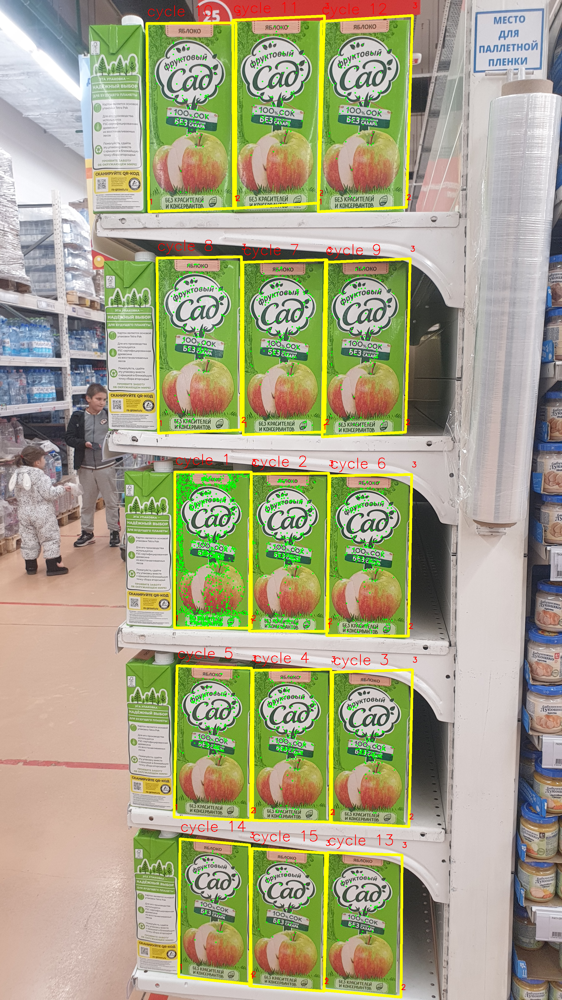

'\ntry2 = predict_image(try1, sok)\ntry3 = predict_image(try2, sok)\ntry4 = predict_image(try3, sok)\ntry5 = predict_image(try4, sok)\ntry6 = predict_image(try5, sok)\ntry7 = predict_image(try6, sok)\ntry8 = predict_image(try7, sok)\ntry9 = predict_image(try8, sok)\ntry10 = predict_image(try9, sok)\ntry11 = predict_image(try10, sok)\ntry12 = predict_image(try11, sok)\ntry13 = predict_image(try12, sok)\ntry14 = predict_image(try13, sok)\ntry15 = predict_image(try14, sok)\ntry16 = predict_image(try15, sok)\n'

In [46]:
polka = cv.imread('/content/train_1.jpg')
sok = cv.imread('/content/template_1.jpg')

try1 = predict_image(polka, sok)

'''
try2 = predict_image(try1, sok)
try3 = predict_image(try2, sok)
try4 = predict_image(try3, sok)
try5 = predict_image(try4, sok)
try6 = predict_image(try5, sok)
try7 = predict_image(try6, sok)
try8 = predict_image(try7, sok)
try9 = predict_image(try8, sok)
try10 = predict_image(try9, sok)
try11 = predict_image(try10, sok)
try12 = predict_image(try11, sok)
try13 = predict_image(try12, sok)
try14 = predict_image(try13, sok)
try15 = predict_image(try14, sok)
try16 = predict_image(try15, sok)
'''


In [51]:
  import numpy as np

  width = 2000
  height = 4000

  corners_query = np.float32([[0, 0], [0, height-1], [width-1, height-1], [width-1, 0]]).reshape(-1, 1, 2)
  lol = corners_query.astype(np.int32)


0
